## Implementing K-means Clustering

by Bing Wang

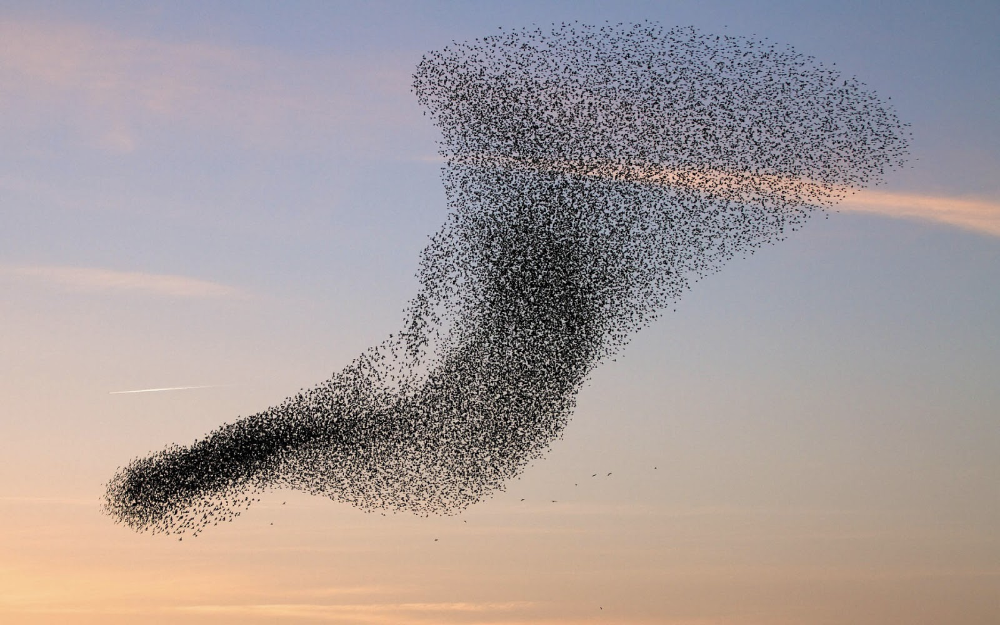

(source: How It Works - https://www.howitworksdaily.com/why-do-birds-flock-together/)

### Overview

**What is clustering?**

Clustering is a technique to learn more about some data/items by grouping similar items based on their traits, without knowing ahead of time whether any of the items belong to the same group. 

In more technical terms, clustering is an unsupervised machine learning technique to group data points into clusters without labels. Since there are no labels, traditional methods of evaluating how well or how "correctly" you have clustered cannot be used here.

**What do we use clustering for?**

Clustering can be used for many different types of problems! One way to use clustering is to get a sense of the relationships between different observations, and get at patterns in the data-- see what data points may be similar. It can be a good way of getting an initial sense of your data if you're not too familiar yet. This can even be used for feature engineering: You can create a new column in your data to specify what cluster a particular data point belongs to.

Examples:
    
    -Flagging fraudulent transactions
    -Identifying fake news 
    -Identiying types of customers/general customer profiles

**What is k-means clustering?**

K-means clustering is a unsupervised, clustering algorithm that assigns data points to one of k clusters based on which cluster's centroid (centermost point) it is closest in distance to (distance is used as a metric of similiarity here). 

### Algorithm

The k-means algorithm is as follows: 

<img src="kmeans.png" width="550">

(source: Terence Parr, MSDS689 notes - https://github.com/parrt/msds689/blob/master/projects/kmeans/kmeans.md)


The algorithm in written steps:

    1. Initialize centroids: Pick k points at random from data set X
    2. Initialize clusters: Calculate the euclidean (minimal) distance of each point in X to each of 
       the k centroids. Assign each point to the centroid it is closest to.
    3. Recalculate centroids: Calculate new centroids as the centroid of each cluster
    4. Recalculate clusters: Re-assign points by the distance metric to one of the new centroids
    5. Repeat steps 4-5 until the centroids are relatively stable: Stop iterating when the difference
       between the old and newly centroids are below a specified tolerance level.
    6. Return final centroids and clusters

K-means++ is a variant of k-means, where the algorithm differs only in its initialization of centroids (step 1):

    1. Initialize centroids:
           a. Pick 1 point at random from X as one of k centroids
           b. Calculate the euclidean (minimal) distance between each point in X to the initial
              random centroid. The point furthest from the first centroid is the second of k centroids.
           c. Repeat step b until all k centroids are assigned, but calculating the distance between
              each point in X and every already assigned centroid, and picking the next centroid as the point
              that is furthest away from its closest centroid. 

NOTE: This is a simplified implementation of k-means++, which uses direct rather than probabilistic assignment of centroids.

K-means++ improves upon k-means' random assignment of initial centroids by spreading them out (centroids are initialized to be as far apart from each other as possible), improving performance and speed.

I have coded up k-means and k-means++ in *kmeans.py*. My functions return a NumPy array of centroids, and a list of lists of cluster assignments, consisting of lists of the indexes of points in X that belong to a given cluster.

Let's see some applications of k-means clustering below.

### Application

In [1]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from PIL import Image
from sklearn.datasets import load_iris

In [2]:
%run kmeans

**Grades** (Toy, 1D dataset)

Let's see k-means applied to a small, made-up dataset of grades. What would the clusters be if we set k=3?

In [3]:
grades = [92.65, 93.87, 74.06, 86.94, 92.26, 94.46, 92.94, 80.65, 92.86,
          85.94, 91.79, 95.23, 85.37, 87.85, 87.71, 93.03]
grades = np.array(grades).reshape(-1, 1)

In [4]:
k=3
tolerance=1e-2

grades_centroids, grades_clusters = kmeans(grades, k)

The centroids calculated are:

Which grades correspond to which clusters?

In [5]:
for i in range(k):
    print("Cluster " + str(i) + ":")
    print("Centroid: " + str(round(grades_centroids[i][0], 2)))
    print(grades[grades_clusters[i]])
    print()

Cluster 0:
Centroid: 94.52
[[93.87]
 [94.46]
 [95.23]]

Cluster 1:
Centroid: 92.59
[[92.65]
 [92.26]
 [92.94]
 [92.86]
 [91.79]
 [93.03]]

Cluster 2:
Centroid: 84.07
[[74.06]
 [86.94]
 [80.65]
 [85.94]
 [85.37]
 [87.85]
 [87.71]]



As we can see, the grades have been groupd into k=3 clusters, with similar grades grouped together with a centroid in their range.

Let's now see another example with the iris dataset, a dataset of 3 different types of irises (Iris Setosa, Versicolor, and Virginica) with the following 4 features (columns or predictors in X):

    1. sepal length in cm
    2. sepal width in cm
    3. petal length in cm
    4. petal width in cm

We will perform k-means clustering with k=3, for the 3 classes.

In [6]:
iris = load_iris()
X = iris.data
y = iris.target

k=3
tolerance=1e-2

iris_centroids, iris_clusters = kmeans(X, k)

Let's compare the real classification labels of the irises to their k-means cluster assignments. 

Since there are 4 different features, let's compare with plots of sepal vs. petal length, then sepal vs. petal width. 

In [7]:
y_pred_clusters = y.copy()
for (c_i, x_i) in enumerate(iris_clusters):
    y_pred_clusters[x_i] = c_i
    # Swap assignments of arbitrarily-assigned cluster number in order for colors to match up with labels in plot
    if c_i==0:
        y_pred_clusters[x_i] = 2
    elif c_i==2:
        y_pred_clusters[x_i] = 0

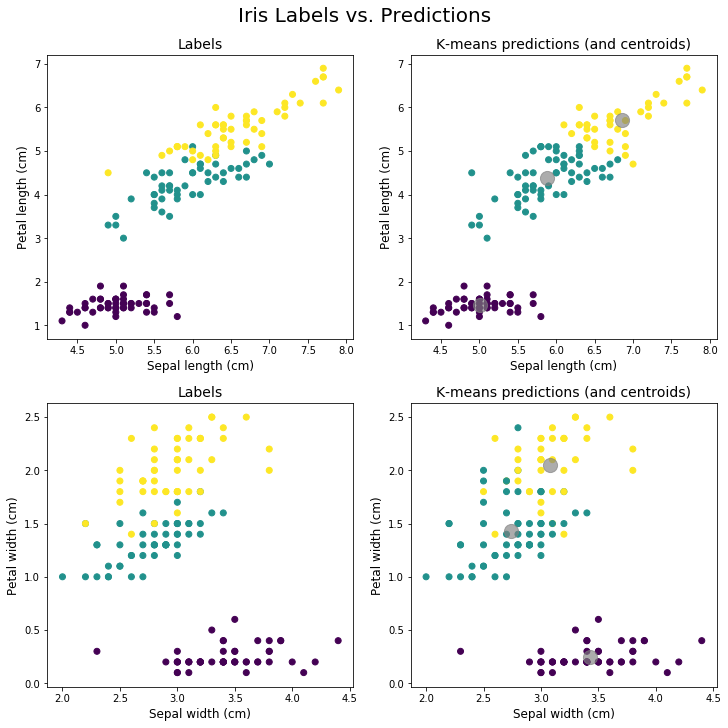

In [8]:
fig, axs = plt.subplots(2, 2, figsize=(10,10), constrained_layout=True)
fig.suptitle('Iris Labels vs. Predictions', fontsize=20)

# Sepal vs. petal length
axs[0, 0].scatter(X[:, 0], X[:, 2], c=y)
axs[0, 0].set_title('Labels', fontsize=14)
axs[0, 0].set_xlabel('Sepal length (cm)', fontsize=12)
axs[0, 0].set_ylabel('Petal length (cm)', fontsize=12)

axs[0, 1].scatter(X[:, 0], X[:, 2], c=y_pred_clusters)
axs[0, 1].scatter(iris_centroids[:, 0], iris_centroids[:, 2], c='gray', s=200, alpha=0.65)
axs[0, 1].set_title('K-means predictions (and centroids)', fontsize=14)
axs[0, 1].set_xlabel('Sepal length (cm)', fontsize=12)
axs[0, 1].set_ylabel('Petal length (cm)', fontsize=12)

# Sepal vs. petal width
axs[1, 0].scatter(X[:, 1], X[:, 3], c=y)
axs[1, 0].set_title('Labels', fontsize=14)
axs[1, 0].set_xlabel('Sepal width (cm)', fontsize=12)
axs[1, 0].set_ylabel('Petal width (cm)', fontsize=12)

axs[1, 1].scatter(X[:, 1], X[:, 3], c=y_pred_clusters)
axs[1, 1].scatter(iris_centroids[:, 1], iris_centroids[:, 3], c='gray', s=200, alpha=0.65)
axs[1, 1].set_title('K-means predictions (and centroids)', fontsize=14)
axs[1, 1].set_xlabel('Sepal width (cm)', fontsize=12)
axs[1, 1].set_ylabel('Petal width (cm)', fontsize=12)

plt.show()

As we can see, our k-means groupings correspond closely to the actual labels, depicting 3 different types of irises.

**Let's now compare the difference between kmeans++ and kmeans.**

In [9]:
iris_centroids_pp, iris_clusters_pp = kmeans(X, k, "kmeans++")

y_pred_clusters_pp = y.copy()
for (c_i, x_i) in enumerate(iris_clusters_pp):
    y_pred_clusters_pp[x_i] = c_i
    # Swap assignments of arbitrarily-assigned cluster number in order for colors to match up with labels in plot
    if c_i==0:
        y_pred_clusters_pp[x_i] = 1
    elif c_i==1:
        y_pred_clusters_pp[x_i] = 0

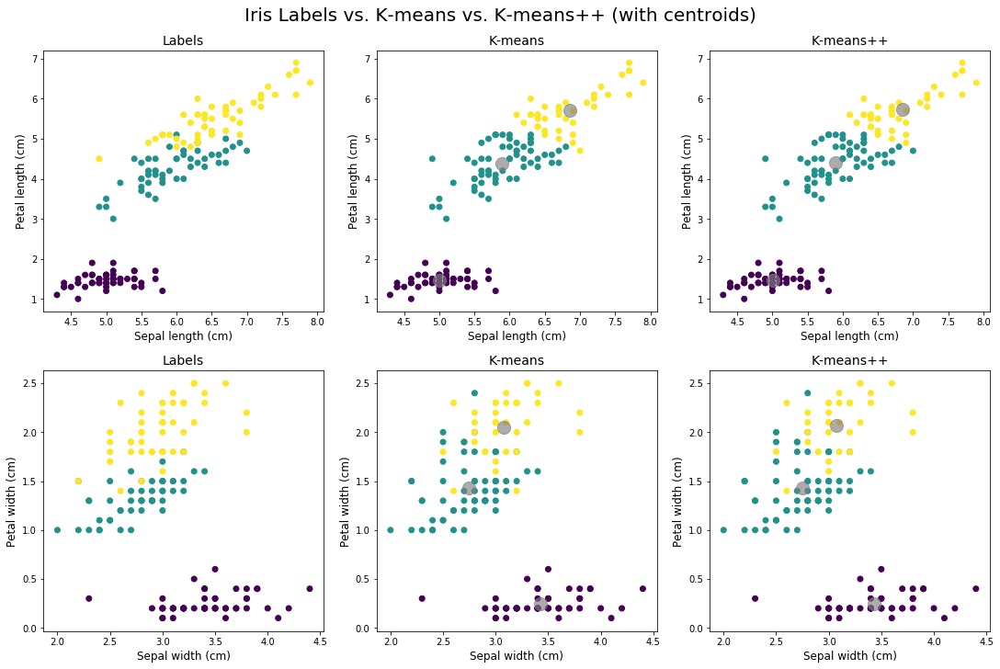

In [10]:
fig, axs = plt.subplots(2, 3, figsize=(15, 10), constrained_layout=True)
fig.suptitle('Iris Labels vs. K-means vs. K-means++ (with centroids)', fontsize=20)

# Sepal vs. petal length
axs[0, 0].scatter(X[:, 0], X[:, 2], c=y)
axs[0, 0].set_title('Labels', fontsize=14)
axs[0, 0].set_xlabel('Sepal length (cm)', fontsize=12)
axs[0, 0].set_ylabel('Petal length (cm)', fontsize=12)

axs[0, 1].scatter(X[:, 0], X[:, 2], c=y_pred_clusters)
axs[0, 1].scatter(iris_centroids[:, 0], iris_centroids[:, 2], c='gray', s=200, alpha=0.65)
axs[0, 1].set_title('K-means', fontsize=14)
axs[0, 1].set_xlabel('Sepal length (cm)', fontsize=12)
axs[0, 1].set_ylabel('Petal length (cm)', fontsize=12)

axs[0, 2].scatter(X[:, 0], X[:, 2], c=y_pred_clusters_pp)
axs[0, 2].scatter(iris_centroids_pp[:, 0], iris_centroids_pp[:, 2], c='gray', s=200, alpha=0.65)
axs[0, 2].set_title('K-means++', fontsize=14)
axs[0, 2].set_xlabel('Sepal length (cm)', fontsize=12)
axs[0, 2].set_ylabel('Petal length (cm)', fontsize=12)

# Sepal vs. petal width
axs[1, 0].scatter(X[:, 1], X[:, 3], c=y)
axs[1, 0].set_title('Labels', fontsize=14)
axs[1, 0].set_xlabel('Sepal width (cm)', fontsize=12)
axs[1, 0].set_ylabel('Petal width (cm)', fontsize=12)

axs[1, 1].scatter(X[:, 1], X[:, 3], c=y_pred_clusters)
axs[1, 1].scatter(iris_centroids[:, 1], iris_centroids[:, 3], c='gray', s=200, alpha=0.65)
axs[1, 1].set_title('K-means', fontsize=14)
axs[1, 1].set_xlabel('Sepal width (cm)', fontsize=12)
axs[1, 1].set_ylabel('Petal width (cm)', fontsize=12)

axs[1, 2].scatter(X[:, 1], X[:, 3], c=y_pred_clusters_pp)
axs[1, 2].scatter(iris_centroids_pp[:, 1], iris_centroids_pp[:, 3], c='gray', s=200, alpha=0.65)
axs[1, 2].set_title('K-means++', fontsize=14)
axs[1, 2].set_xlabel('Sepal width (cm)', fontsize=12)
axs[1, 2].set_ylabel('Petal width (cm)', fontsize=12)

plt.show()

As we can see, there are subtle differences in cluster assignments and centroids, but at least in this example, the clusters are largely identical. 

Since k-means++ is meant to be an improvement upon k-means, we will continue using k-means++ going forward.

### Application to image compression

Let's apply clustering to image compression, by using our kmeans function to cluster the pixels in our images, in order to convert a picture of many colors to a picture of just k colors, while maintaining the integrity of the image as much as possible. An image is just a matrix of pixels after all-- each pixel corresponding to a scalar number indicating what color it should be.

Let's first begin with a grayscale image. (This is a picture of my dog, Choco!)

We will be using the Pillow Python package, built upon the Python Imaging Library, in order to read in and manipulate images.

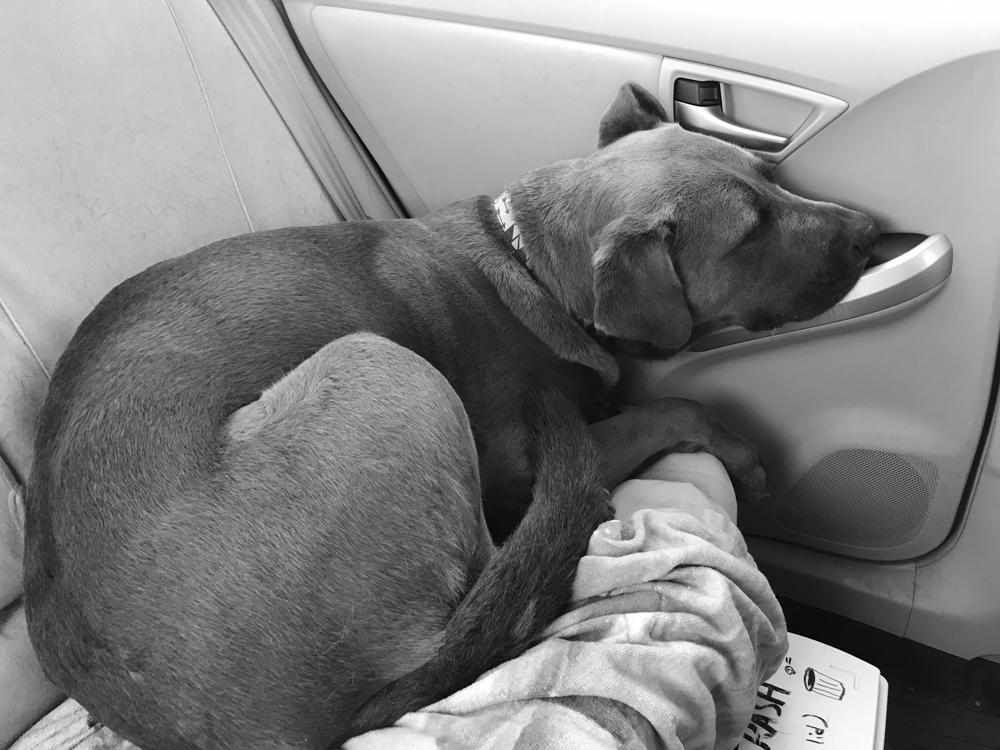

In [11]:
image_gray = Image.open("choco.png").convert("L")
image_gray.save("choco_gray.png")
image_gray

Let's get the matrix of pixels out from the image, as a numpy array. 

NOTE: My k-means algorithm treats each row in a matrix as one item/data point when clustering. Since each pixel in an image matrix is an individual entity (with one scalar numerical value each), we will first unravel the matrix into a 1D vector before performing clustering.

Let's see how this picture looks when compresed into a picture of k=4 shades of gray.

In [12]:
mat_image_gray = np.array(image_gray)/1.0 # convert to float
mat_image_gray_vec = mat_image_gray.ravel().reshape(-1,1)  # convert to vector of individual pixels

centroids_gray, clusters_gray = kmeans(mat_image_gray_vec, 4, "kmeans++")

In [13]:
def replace_w_centroid_value(X: np.array, clusters: np.array, centroids: np.array, k: int):
    '''Replace X values with the centroid value calculated with k-means'''
    for i in range(k):
        X[clusters[i], :] = centroids[i]
    return X

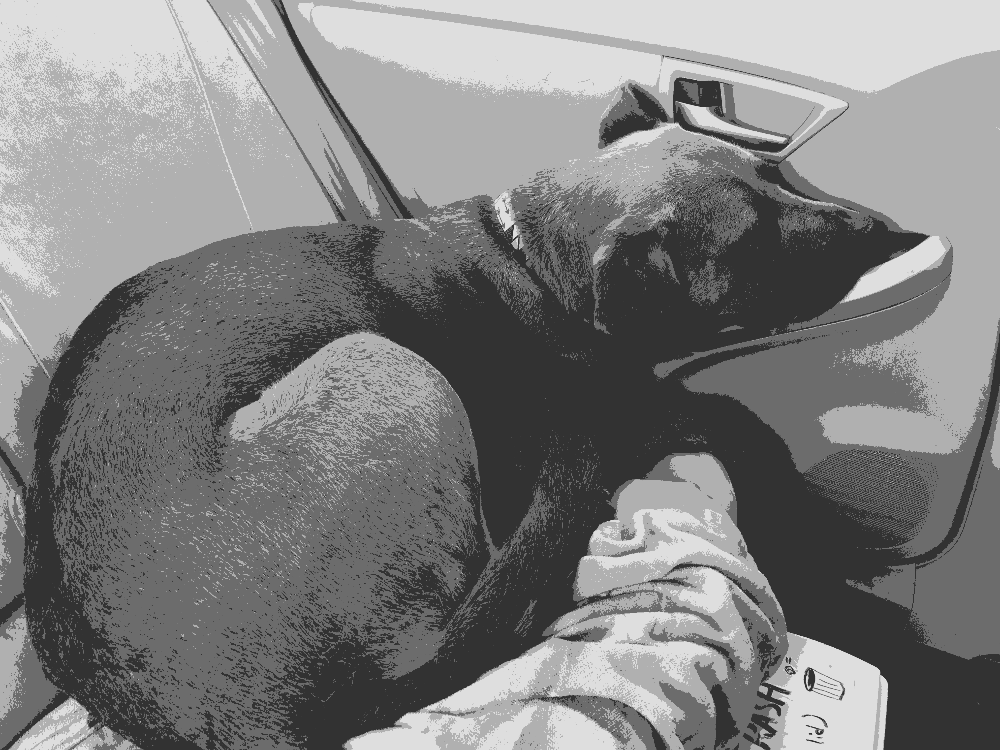

In [14]:
mat_image_4gray = replace_w_centroid_value(mat_image_gray_vec, clusters_gray, centroids_gray, 4) \
                        .reshape(mat_image_gray.shape)

image_4gray = Image.fromarray(mat_image_4gray).convert('RGB')
image_4gray.save("choco_4gray.png")
image_4gray

Cool effect, right? We can see that it is the same image, but using only 4 shades of gray, rather than hundreds.

**Now let's try again with this image in color.**

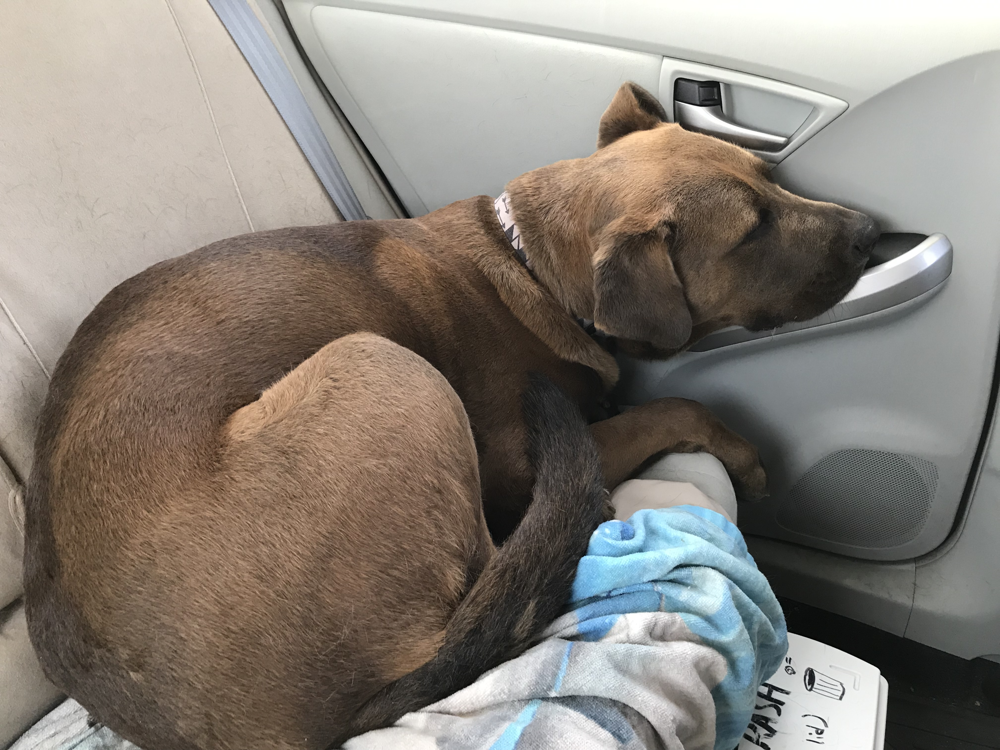

In [15]:
image = Image.open("choco.png")
image

We will reduce the picture down to k=32 colors using k-means.

NOTE: Since the picture is now in color, each color pixel is represented by a vector of 4 columns (indicating RGBA: red, green, blue and opacity) rather than just 1 in the grayscale case (indicating opacity; how dark the gray should be). Thus, when we unravel the 3D image matrix, we will be careful to keep each pixel's vector intact.

In [16]:
mat_image = np.array(image)/1.0  # convert to float
mat_image_vec = mat_image.reshape(-1,4)  # convert to vector of individual pixel vectors

centroids, clusters = kmeans(mat_image_vec, 32)

In [17]:
mat_image32 = replace_w_centroid_value(mat_image_vec.copy(), clusters, centroids, 32) \
                        .reshape(mat_image.shape)
mat_image32 = mat_image32.astype('uint8')  # Image did not accept float64 type

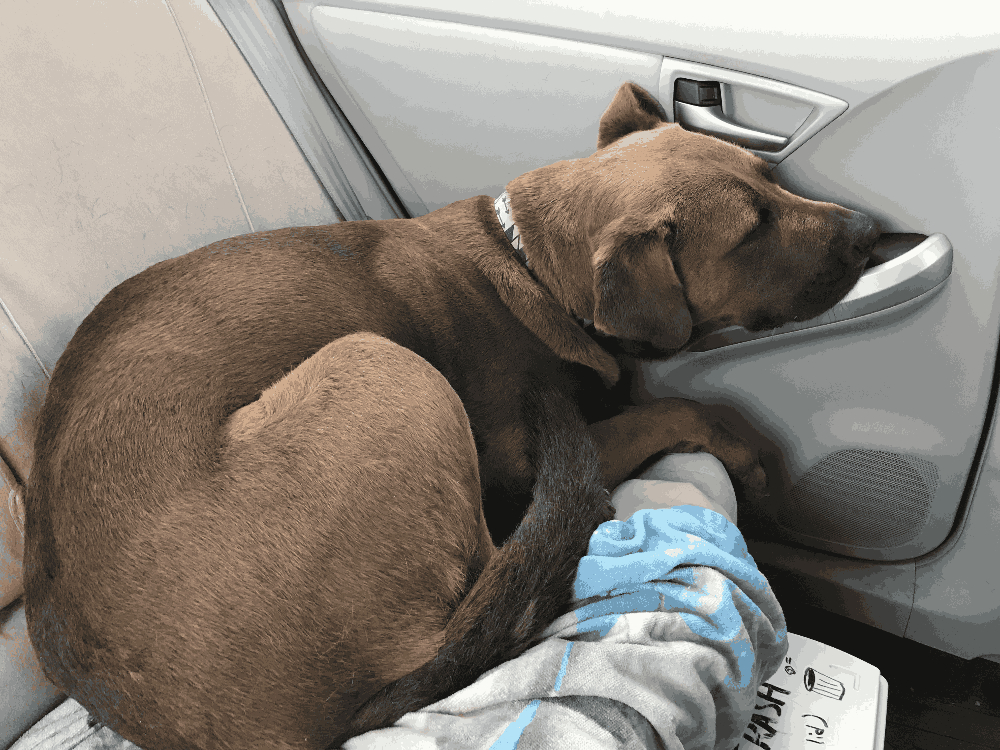

In [18]:
image32 = Image.fromarray(mat_image32).convert('RGB')
image32.save("choco32.png")
image32

As we can see, similar to the case with 4 grays, we can see the compressed effect on the color photo using only 32 colors.

### Conclusion

And there you have it! K-means can have a wide array of applications, as we showed through some examples here. The absence of labels in this unsupervised clustering algorithm can be beneficial when doing initial data exploration in the absense of conclusive labels or classifications on items. It can also be used to see or confirm the relationship between features and the label, as we saw in the iris example--clusters were close to the actual labels, though classes were not perfectly separated--as is often the case with real life data. 

I hope you see the benefits and uses of this algorithm, and find uses for it in your own data science workflow.